# Exercise 2: Visualizing and selecting Swarm data for modelling

This is a simple python (jupyter) notebook for reading Swarm L1B Mag cdf data files for starting Exercise 2 in DTU's MSc Earth and Planetary magnetism course.

Chris Finlay with input from Eigil Lippert, Mikkel Otzen and Clemens Kloss

In the following notebook it will be demonstrated how to carry out data selection on typical Swarm data products, and plot some relevant geomagnetic features.  Uses pandas for data manipulation

Requires one has installed the necessary packages in your environment (see EPM_environ.txt)


In [3]:
import cdflib
import pandas as pd
import numpy as np
from datetime import datetime
import os
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
from lib.solar_emphemeris import *
import chaosmagpy
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import seaborn as sns


#from chaosmagpy.model_utils import design_gauss, synth_values


In [4]:
# Define Paths and Files to read
DST_PATH = "Disturbance_Indices/Dst_MJD_1998.dat"
KP_PATH = "Disturbance_Indices/Kp_MJD_1998_QL.dat"
DATA_PATH = "Data/"

# (i) Load data

In [5]:
# Load in Dst and Kp indices:
time_Dst, Dst = np.loadtxt(DST_PATH, usecols=(0,1), comments='#',unpack=True)
time_Kp, Kp = np.loadtxt(KP_PATH, usecols=(0,1), comments='#',unpack=True)

# Put into pandas dataframe for easy access
Dst_indices = pd.DataFrame({'time_Dst': time_Dst, 'Dst': Dst})
Kp_indices = pd.DataFrame({'time_Kp': time_Kp, 'Kp': Kp})


In [6]:
# Load Swarm data
i = 0
dataframe = []  # create a temporary empty list

for folder, subfolder, files in os.walk(DATA_PATH):
    for file in sorted(list(files)):
        # if there is any non-cdf files in your folder they will be skipped:
        try:
            
            cdf_file = cdflib.CDF(folder + file)
            time_stamps = cdf_file.varget("Timestamp")  # CDF epoch is in miliseconds since 01-Jan-0000\n",
            print(folder + file)

            #tmp = (time_stamps - time_stamps[0]) / (1e3*60*60*24) + to_mjd2000(2018, 9, 14+i)
            mjd2000_time = (time_stamps - time_stamps[0]) / (1e3*60*60*24) + to_mjd2000(2018, 9, 14+i)  # 
            radii = cdf_file.varget("Radius")/1e3
            theta = 90 - cdf_file.varget("Latitude")
            phi = cdf_file.varget("Longitude")
            b_nec = cdf_file.varget("B_NEC")
            flags_b = cdf_file.varget("Flags_b")
            flags_q = cdf_file.varget("Flags_q")

            # append to list (list of dataframes)
            dataframe.append(pd.DataFrame({
                'time_stamp': mjd2000_time,
                'radius': radii,
                'colat': theta,
                'lon': phi,
                'X': b_nec[:, 0],
                'Y': b_nec[:, 1],
                'Z': b_nec[:, 2],
                'flags_b': flags_b,
                'flags_q': flags_q
            }))

            i += 1

        except OSError:
            print('Error could not open file:', "\n", file)
            pass


# save memory
del mjd2000_time, radii, theta, phi, b_nec, flags_q, flags_b
            
# convert list to single dataframe using pandas.concat
dataframe = pd.concat(dataframe, ignore_index=True)

print('shape of dataframe:', dataframe.shape)
dataframe.head(10)


Data/SW_OPER_MAGB_LR_1B_20180914T000000_20180914T235959_0505_MDR_MAG_LR.cdf
Data/SW_OPER_MAGB_LR_1B_20180915T000000_20180915T235959_0505_MDR_MAG_LR.cdf
Data/SW_OPER_MAGB_LR_1B_20180916T000000_20180916T235959_0505_MDR_MAG_LR.cdf
Data/SW_OPER_MAGB_LR_1B_20180917T000000_20180917T235959_0505_MDR_MAG_LR.cdf
Data/SW_OPER_MAGB_LR_1B_20180918T000000_20180918T235959_0505_MDR_MAG_LR.cdf
Data/SW_OPER_MAGB_LR_1B_20180919T000000_20180919T235959_0505_MDR_MAG_LR.cdf
Data/SW_OPER_MAGB_LR_1B_20180920T000000_20180920T235959_0505_MDR_MAG_LR.cdf
Data/SW_OPER_MAGB_LR_1B_20180921T000000_20180921T235959_0505_MDR_MAG_LR.cdf
Data/SW_OPER_MAGB_LR_1B_20180922T000000_20180922T235959_0505_MDR_MAG_LR.cdf
Data/SW_OPER_MAGB_LR_1B_20180923T000000_20180923T235959_0505_MDR_MAG_LR.cdf
Data/SW_OPER_MAGB_LR_1B_20180924T000000_20180924T235959_0505_MDR_MAG_LR.cdf
Data/SW_OPER_MAGB_LR_1B_20180925T000000_20180925T235959_0505_MDR_MAG_LR.cdf
Data/SW_OPER_MAGB_LR_1B_20180926T000000_20180926T235959_0505_MDR_MAG_LR.cdf
Data/SW_OPER

,time_stamp,radius,colat,lon,X,Y,Z,flags_b,flags_q
0,6831.000000,6871.86830,27.941087,123.608234,10403.1199,-2120.5559,46117.2698,0,0
1,6831.000012,6871.85933,27.877814,123.615449,10370.9552,-2115.6103,46130.9097,0,0
2,6831.000023,6871.85037,27.814542,123.622711,10338.8153,-2110.9086,46144.4124,0,0
3,6831.000035,6871.84143,27.751270,123.630022,10306.7421,-2106.2247,46157.8169,0,0
4,6831.000046,6871.83250,27.687999,123.637381,10274.7163,-2101.7993,46171.1290,0,0
5,6831.000058,6871.82359,27.624729,123.644789,10242.5316,-2097.0032,46184.3758,0,0
6,6831.000069,6871.81469,27.561460,123.652245,10210.4270,-2091.9564,46197.5425,0,0
7,6831.000081,6871.80581,27.498192,123.659752,10178.1634,-2087.6542,46210.6096,0,0
8,6831.000093,6871.79695,27.434925,123.667307,10146.8038,-2081.9889,46223.4304,0,0
9,6831.000104,6871.78810,27.371658,123.674913,10114.7021,-2077.2174,46236.3271,0,0


In [7]:
# drop nans, if any
dataframe = dataframe.dropna()

# check for error flags. Where flag_b or flag_q is 255

# drops rows where flag_b == 255
dataframe.drop(dataframe[dataframe.flags_b == 255].index, inplace=True)

# drops rows where flag_q == 255
dataframe.drop(dataframe[dataframe.flags_q == 255].index, inplace=True)

# (ii) Down-sample data

In [8]:
# Take every 60th datum

# Extract every 60th element
every_60th_data = dataframe[::60]

dataframe60 = every_60th_data

print(every_60th_data.shape)

(21600, 9)


# (iii) Exploratory plots of vector field components vs co-latitude and time

In [9]:

# Converting the data to arrays
X = dataframe60.iloc[:,4].to_numpy(dtype=float)
Y = dataframe60.iloc[:,5].to_numpy(dtype=float)
Z = dataframe60.iloc[:,6].to_numpy(dtype=float)
lon = dataframe60.iloc[:,3].to_numpy(dtype=float)
colat = dataframe60.iloc[:,2].to_numpy(dtype=float)
time_stamp = dataframe60.iloc[:,0].to_numpy(dtype=float)

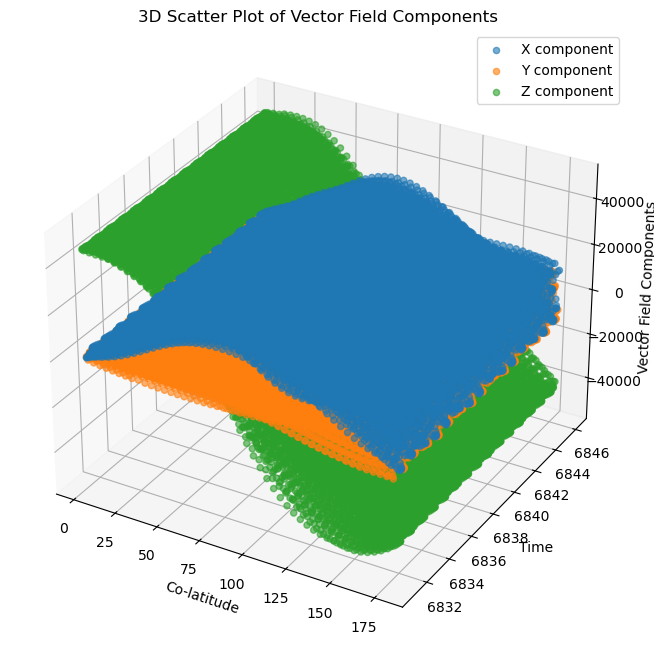

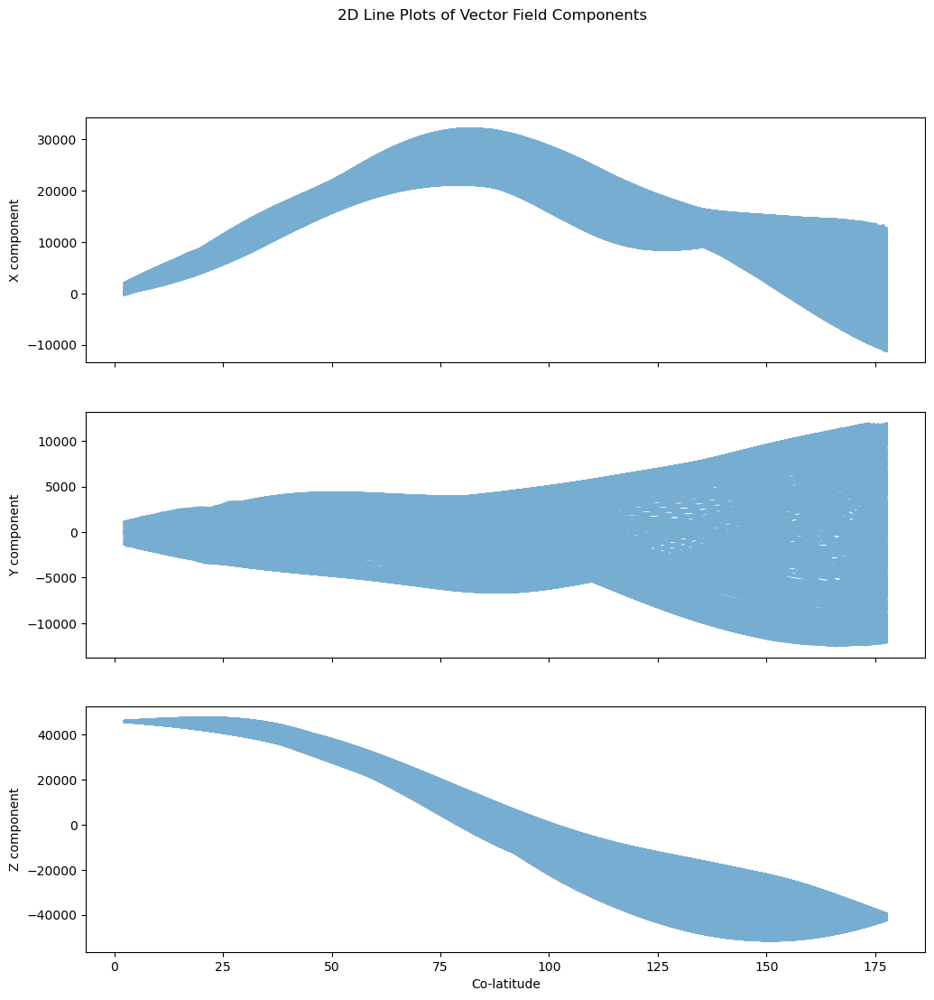

In [10]:
# Plot the vector field components against co-latitude and time.

# 3D Scatter Plot
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(colat, time_stamp, X, label='X component', alpha=0.6)
ax.scatter(colat, time_stamp, Y, label='Y component', alpha=0.6)
ax.scatter(colat, time_stamp, Z, label='Z component', alpha=0.6)

ax.set_xlabel('Co-latitude')
ax.set_ylabel('Time')
ax.set_zlabel('Vector Field Components')
ax.set_title('3D Scatter Plot of Vector Field Components')
ax.legend()
plt.show()

# 2D Line Plots
fig, axs = plt.subplots(3, 1, figsize=(12, 12), sharex=True)

axs[0].plot(colat, X, label='X component', alpha=0.6)
axs[1].plot(colat, Y, label='Y component', alpha=0.6)
axs[2].plot(colat, Z, label='Z component', alpha=0.6)

axs[0].set_ylabel('X component')
axs[1].set_ylabel('Y component')
axs[2].set_ylabel('Z component')
axs[2].set_xlabel('Co-latitude')
fig.suptitle('2D Line Plots of Vector Field Components')
plt.show()

# (iv) Remove Sunlight data

In [11]:
# removing sunlit data
rad = np.pi/180
zenith = 90-10  # zenith angle 80 deg


# threshold for dark time observation
cos_zeta_0 = np.cos((zenith) * rad)
_, declination = sun_mjd2000(dataframe60.time_stamp.values)
cos_zeta = np.cos(colat * rad) * np.sin(declination) \
         + np.sin(colat * rad) * np.cos(declination) * np.cos(np.mod(time_stamp + .5, 1) * 2*np.pi + lon * rad)


dataframe_sunlit = dataframe60.loc[cos_zeta <= cos_zeta_0].copy()
len(dataframe_sunlit)


15039

# (v) Implement quiet time selection based on rate of change of Dst and Kp

In [12]:
# Calculating the hourly difference between all Dst measurements.
Dst_indices['Dst_Hourly_Difference'] = Dst_indices.Dst.diff();

# Interpolating all the Kp measurements within the time period of our Swarm data measurements. The Kp measurements span a 3 hour interval, they are interpolated so 1 kp value is assigned to each 1 minute Swarm data measurement.
dataframe_sunlit['Kp10'] = np.interp(dataframe_sunlit.time_stamp.values, Kp_indices.time_Kp.values, Kp_indices.Kp.values);
# Interpolating all the Dst hourly difference measurements within the time period of our Swarm data measurements. The Dst measurements span a 1 hour interval, they are interpolated so 1 hourly difference value is assigned to each 1 minute Swarm data measurement.
dataframe_sunlit['dDst'] = np.abs(np.interp(dataframe_sunlit.time_stamp.values, Dst_indices.time_Dst.values, Dst_indices.Dst_Hourly_Difference.values));


# We extract all the Swarm data measurement corresponding to a Kp10 index of 30 or below along with an hourly change in Dst of 3 nT or below (i.e. filtering away all the data corresponding to high external geomagnetic activity).
dataframe_quiet = dataframe_sunlit.query('Kp10 <= 30 & dDst <= 3');

# Calculating the number of data rows left after sunlit+quiet time filtering and storing it as a variable.
sunlit_quiet_filtered_data_length = len(dataframe_quiet);
pd.set_option('display.max_rows', 30);


print(len(dataframe_quiet))

# Percentage of down-sampled data that is bot dark and quiet
result_string = 'Percentage of down-sampled data that is both dark and quiet: {:.2f}%'.format(len(dataframe_quiet) / len(dataframe60) * 100)
print(result_string)


10114
Percentage of down-sampled data that is both dark and quiet: 46.82%


# (vi) Convert to field intensity F and plot vs co-latitude and longitude

max is 51621.40
min is 18355.54
Highest intensity at Latitude: 149.3159422, Longitude: 137.76029929999999, Intensity: 51621.39846762571
Lowest intensity at Latitude: 112.4804884, Longitude: -57.2617036, Intensity: 18355.539094347056


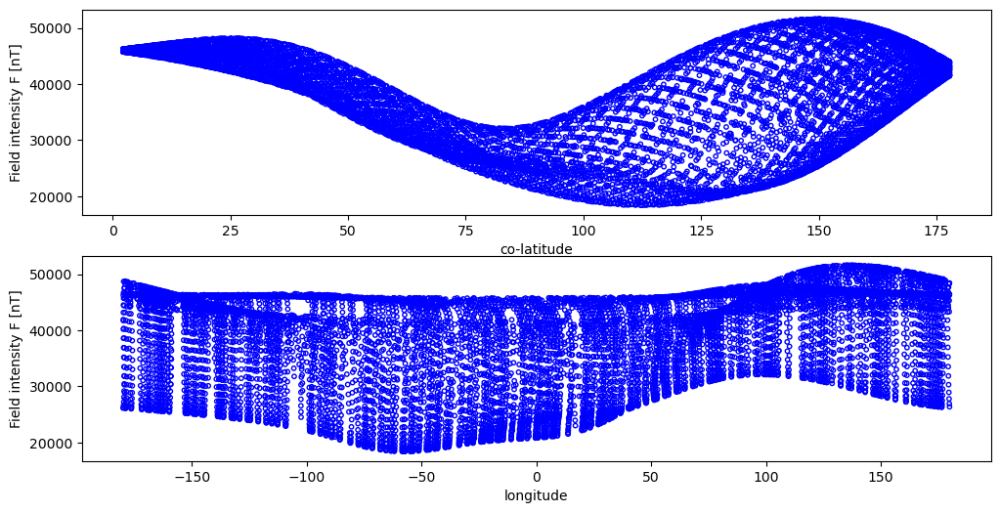

In [13]:
# Calculate field intensity and plot 

# Calculate field intensity and plot 
F = np.sqrt(dataframe_quiet['X']**2 + dataframe_quiet['Y']**2 + dataframe_quiet['Z']**2).values # Without index

plt.figure(figsize=(12, 6))

plt.subplot(2, 1, 1)
plt.scatter(dataframe_quiet['colat'], F, s = 10, facecolors='none', edgecolors='blue')
plt.ylabel('Field intensity F [nT]')
plt.xlabel('co-latitude')

plt.subplot(2, 1, 2)
plt.scatter(dataframe_quiet['lon'], F, s = 10, facecolors='none', edgecolors='blue')
plt.ylabel('Field intensity F [nT]')
plt.xlabel('longitude')



# Highest and lowest amplitudes in F
print(f'max is {max(F):.2f}')
print(f'min is {min(F):.2f}')

# Find the index of the maximum and minimum values
max_index = np.argmax(F)
min_index = np.argmin(F)

# Extract the corresponding latitude and longitude
latitude_max = dataframe_quiet['colat'].iloc[max_index]
longitude_max = dataframe_quiet['lon'].iloc[max_index]
latitude_min = dataframe_quiet['colat'].iloc[min_index]
longitude_min = dataframe_quiet['lon'].iloc[min_index]

# Print the results
print(f'Highest intensity at Latitude: {latitude_max}, Longitude: {longitude_max}, Intensity: {F[max_index]}')
print(f'Lowest intensity at Latitude: {latitude_min}, Longitude: {longitude_min}, Intensity: {F[min_index]}')


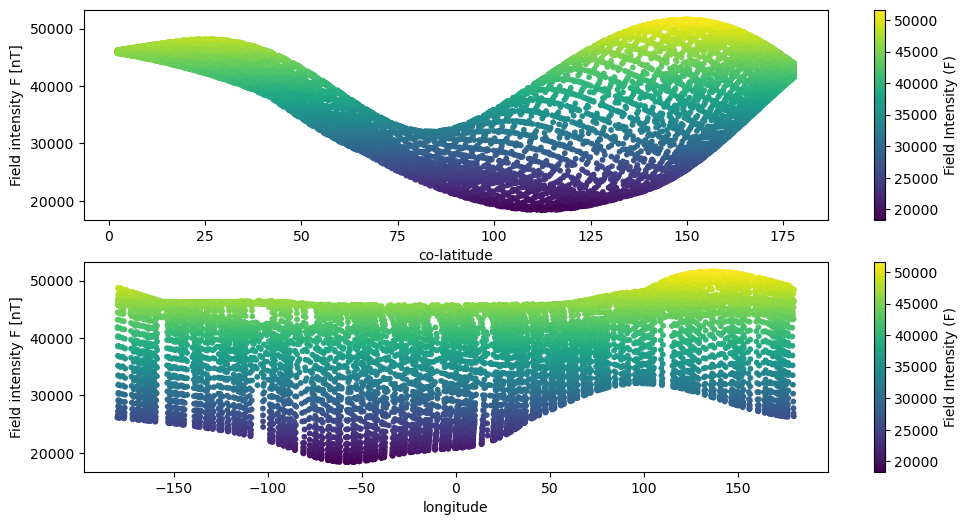

In [14]:
# same as above but with colorbar

plt.figure(figsize=(12, 6))

# Subplot 1
plt.subplot(2, 1, 1)
sc1 = plt.scatter(dataframe_quiet['colat'], F, s=10, c=F, cmap='viridis')
plt.ylabel('Field intensity F [nT]')
plt.xlabel('co-latitude')

# Add colorbar for subplot 1
cbar1 = plt.colorbar(sc1, label='Field Intensity (F)', orientation='vertical')

# Subplot 2
plt.subplot(2, 1, 2)
sc2 = plt.scatter(dataframe_quiet['lon'], F, s=10, c=F, cmap='viridis')
plt.ylabel('Field intensity F [nT]')
plt.xlabel('longitude')

# Add colorbar for subplot 2
cbar2 = plt.colorbar(sc2, label='Field Intensity (F)', orientation='vertical')

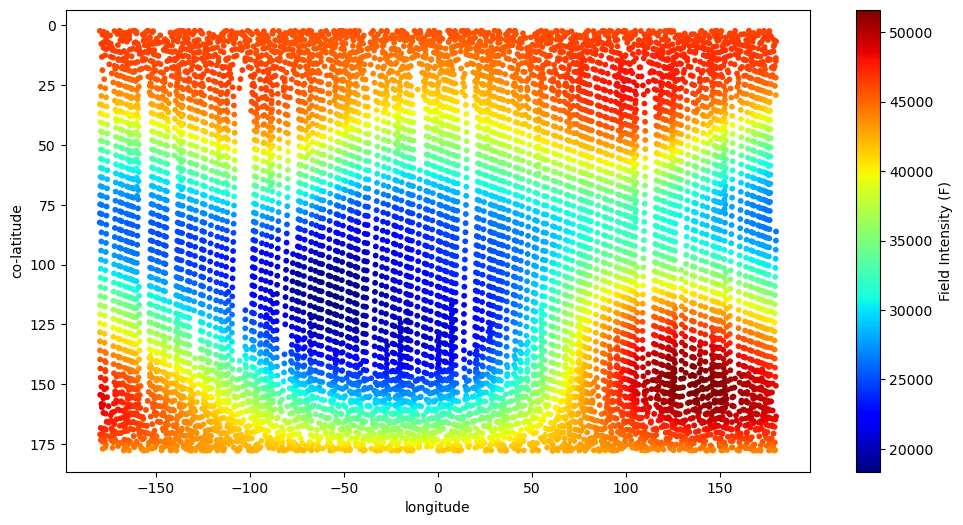

In [15]:

plt.figure(figsize=(12, 6))

sc = plt.scatter(dataframe_quiet['lon'], dataframe_quiet['colat'], s=10, c=F, cmap='jet')
plt.ylabel('co-latitude')
plt.xlabel('longitude')
plt.gca().invert_yaxis()
# Add colorbar
cbar = plt.colorbar(sc, label='Field Intensity (F)', orientation='vertical')

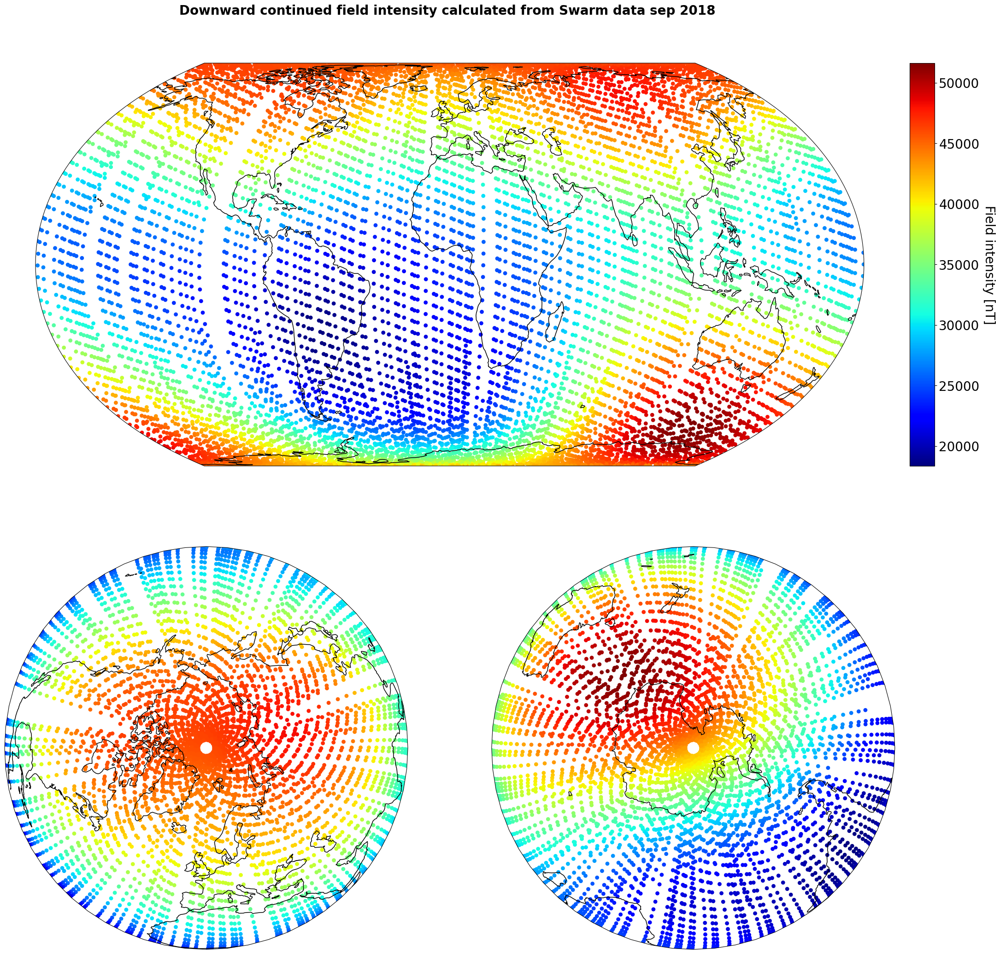

In [16]:
figure = plt.figure(figsize=(25, 25)) # Plot is from Chris' solution
gs = fig.add_gridspec(2, 2)

axes = []
axes.append(plt.subplot(gs[1, 0], projection=ccrs.Orthographic(0,90)))
axes.append(plt.subplot(gs[1, 1], projection=ccrs.Orthographic(180,-90)))
axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

for ax in axes:
        pc = ax.scatter(dataframe_quiet['lon'], y=90-dataframe_quiet['colat'], s = 40, c = F, edgecolors='none', cmap='jet', transform = ccrs.PlateCarree());
        ax.coastlines(linewidth=1.1);

# Add colorbar
    #inset axes into global map and move upwards
plt.title('Downward continued field intensity calculated from Swarm data sep 2018 \n \n \n', weight='bold', fontsize=20);
cax = inset_axes(axes[-1], width="3%", height="100%", loc='right',
                     borderpad=-11)

    # use last artist for the colorbar
clb = plt.colorbar(pc, cax=cax)
clb.ax.tick_params(labelsize=20)
clb.set_label('Field intensity [nT]', rotation=270, labelpad=25, fontsize=20)

# (vii) Convert to $B_r$, $B_\theta$, $B_\lambda$ and save to file for later

In [17]:
# save to selected data to file, e.g. python file or ascii 


# save to selected data to file, e.g. python file or ascii 
dataframe_quiet['Br'] = -dataframe_quiet['Z'];
dataframe_quiet['Btheta'] = -dataframe_quiet['X'];
dataframe_quiet['Bphi'] = dataframe_quiet['Y'];

# Saves the dataframe as a file in the same directory where this current Python file is located.
dataframe_quiet.to_csv('Exercise_2_results.csv',index=False);



#df

C:\Users\alber\AppData\Local\Temp\ipykernel_11784\3024168208.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe_quiet['Br'] = -dataframe_quiet['Z'];
C:\Users\alber\AppData\Local\Temp\ipykernel_11784\3024168208.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe_quiet['Btheta'] = -dataframe_quiet['X'];
C:\Users\alber\AppData\Local\Temp\ipykernel_11784\3024168208.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

In [18]:
data = pd.read_table("Exercise_2_results.csv", delimiter=",")
print(data)

        time_stamp      radius      colat         lon          X          Y  \
0      6831.266667  6869.86541   8.592940   38.094199  3854.3627  1469.4564   
1      6831.267361  6869.71645   5.016398   49.375281  2331.2434  1274.2003   
2      6831.268056  6869.63966   2.350246   95.877236   504.9125  1075.8616   
3      6831.268750  6869.63570   3.862415  166.631628   620.4639   212.3702   
4      6831.269444  6869.70449   7.303994 -175.861425  2193.7555   228.8128   
...            ...         ...        ...         ...        ...        ...   
10109  6845.996528  6871.42086  28.917013  105.414911  9929.4872  -690.3158   
10110  6845.997222  6870.95224  25.120862  105.894271  8039.3775  -533.5363   
10111  6845.997917  6870.54360  21.329249  106.614264  6316.1830  -363.9729   
10112  6845.998611  6870.19866  17.545306  107.730748  4779.6537  -199.6832   
10113  6845.999306  6869.92066  13.775551  109.568872  3437.8059   -53.4189   

                Z  flags_b  flags_q       Kp10     

# Assignment 1

# (ii) Build Design matrix

In [19]:
G_radius, G_theta, G_phi = chaosmagpy.model_utils.design_gauss(data['radius'].values, data['colat'].values, data['lon'].values, 
                                    nmax=13) #, *, nmin=None, mmax=None, source=None)

print(f"The number of rows are {G_radius.shape[0]} and the number of columns are {G_radius.shape[1]}.")


print(G_radius.shape)
print(G_theta.shape)
print(G_phi.shape)

The number of rows are 10114 and the number of columns are 195.
(10114, 195)
(10114, 195)
(10114, 195)


# (iii) Least square solution

In [20]:
G = np.vstack((G_radius, G_theta, G_phi))
d = np.hstack((data['Br'].values, data['Btheta'].values, data['Bphi'].values))

m = np.linalg.solve(G.T@G, G.T@d)

change = abs(-29446 - m[0])/4
print('\n Since 2014, g01 has changed by an average of', change, 'nT per year')

print(m.shape)


 Since 2014, g01 has changed by an average of 6.888738995091444 nT per year
(195,)


In [21]:
# m_by_r = np.linalg.pinv(G_radius) @ data['Br'].values
# m_by_theta = np.linalg.pinv(G_theta) @ data['Btheta'].values
# m_by_phi = np.linalg.pinv(G_phi) @ data['Bphi'].values

# m = np.mean([m_by_r, m_by_theta, m_by_phi], axis = 0)
# m_old = m.copy()

# the field is axis-symmetric for m = 0 and the following finds the indices of these coefficients
# m0 = []; n = 1
# while True:
    # i = n**2 - 1
    # if i < 195:
        # m0.append(i)
        # n += 1
    # else:
        # break

# for i in m0:
    # m[i] = np.mean([m_by_r[i], m_by_theta[i]], axis = 0) # corrects m-values, so that they are not influenced by phi

# m_old2 = m.copy()

# the field is equatorially symmetric for m = n, same as above is done for those coefficients
# men = [1, 2]; n = 3
# while True:
    # i = n**2 - 2
    # if i < 195:
        # men.append(i - 1)
        # men.append(i)
        # n += 1
    # else:
        # break
# 
# for i in men:
    # m[i] = np.mean([m_by_r[i], m_by_phi[i]], axis = 0) # corrects m-values, so that they are not influenced by theta



# print('The following coefficients are corrected when taking zero-order functions into account:\n', m_old - m)
# plt.plot(np.arange(0, 195), m, linestyle = '--')
# plt.scatter(np.arange(0, 195), m, s = 7, color = 'red',  label = 'After m = 0 and m = n corrections')
# plt.scatter(np.arange(0, 195), m_old2, s = 7, color = 'green', label = 'After m = 0, before m = n corrections')
# plt.scatter(np.arange(0, 195), m_old, s = 7, color = 'black', label = 'Before corrections')
# plt.xlim(-1, 35)
# plt.legend()
# plt.xlabel('Coefficient no.')
# plt.ylabel('Amplitude')
    
# print('Amplitude of the first model coefficient (calulated as an averge of its value by r and theta), g01 =', m[0])
# print('When calculated only by radius, g01 =', m_by_r[0])

# change = abs(-29446 - m[0])/4
# print('\n Since 2014, this value (the first) has changed by an average of', change, 'nT per year')

In [22]:
# G = G_radius
# d = Br_loaded

# m_r = np.linalg.inv(G_radius.T @ G_radius) @ G_radius.T @ Br_loaded
# m_t = np.linalg.inv(G_theta.T @ G_theta) @ G_theta.T @ Btheta_loaded
#m_p = np.linalg.inv(G_phi.T @ G_phi) @ G_phi.T @ Blambda_loaded

# first coefficient g01
# print(f"The first coefficient g01 is {m_r[0]}")

# change = ((29446)-abs(m_r[0]))/4
# print(f"The first spherical harmonic model coefficient has per average changed {change} nT per year from 2014 to 2018 ")

In [23]:
# Initializing m
# m = np.empty([G_radius.shape[0], G_radius.shape[1]])


# for i in range(len(G_radius)):
    # G = np.stack((G_radius[i,:], G_theta[i,:], G_phi[i,:]), axis=0)

    # m[i,:] = np.linalg.inv(G.T @ G) @ G.T @ d[i,:]


# print(m.shape)


# first coefficient g01
# print(m[:,0])
# print(m[0,0])


#change = (abs(m[0,0])-(29446))/4
#print(f"The first spherical harmonic model coefficient has per average changed {change} nT per year from 2014 to 2018 ")

# (iv) Residuals between model predictions and the Swarm data

c:\Users\alber\anaconda3\envs\EPM\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\alber\anaconda3\envs\EPM\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\alber\anaconda3\envs\EPM\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


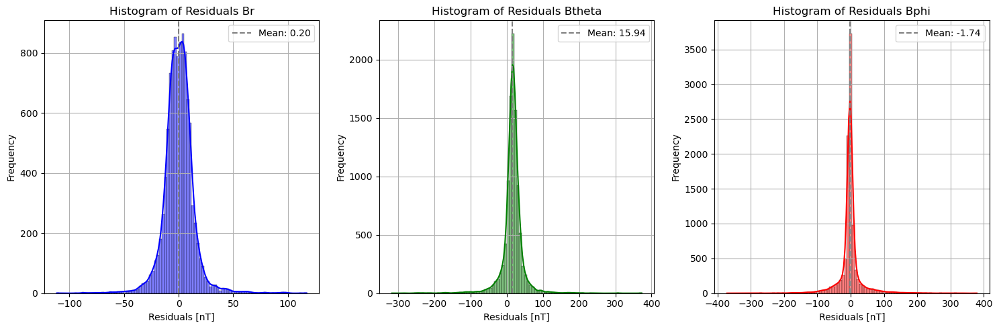

RMS error for Br component: 13.820499906358425
RMS error for Btheta component: 35.00596615409492
RMS error for Bphi component: 38.3331474095356


In [24]:
# Calculating the residuals

# magnetic components computed from the model
Br_pred = G_radius @ m
Bt_pred = G_theta @ m 
Bp_pred = G_phi @ m 



#d_pred = np.column_stack((Br_pred, Bt_pred, Bp_pred))


residuals_r = data['Br'] - Br_pred
residuals_t = data['Btheta'] - Bt_pred
residuals_p = data['Bphi'] - Bp_pred


# Calculate mean of residuals for each component
mean_residuals_r = np.mean(residuals_r)
mean_residuals_t = np.mean(residuals_t)
mean_residuals_p = np.mean(residuals_p)

# Plot histogram of residuals
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Plot histogram of residuals_r with density curve
sns.histplot(residuals_r, bins=100, color='blue', kde=True, ax=axs[0])
axs[0].axvline(x=mean_residuals_r, color='grey', linestyle='--', label=f'Mean: {mean_residuals_r:.2f}')
axs[0].set_xlabel('Residuals [nT]')
axs[0].set_ylabel('Frequency')
axs[0].set_title('Histogram of Residuals Br')
axs[0].legend()
axs[0].grid(True)

# Plot histogram of residuals_t with density curve
sns.histplot(residuals_t, bins=100, color='green', kde=True, ax=axs[1])
axs[1].axvline(x=mean_residuals_t, color='grey', linestyle='--', label=f'Mean: {mean_residuals_t:.2f}')
axs[1].set_xlabel('Residuals [nT]')
axs[1].set_ylabel('Frequency')
axs[1].set_title('Histogram of Residuals Btheta')
axs[1].legend()
axs[1].grid(True)

# Plot histogram of residuals_p with density curve
sns.histplot(residuals_p, bins=100, color='red', kde=True, ax=axs[2])
axs[2].axvline(x=mean_residuals_p, color='grey', linestyle='--', label=f'Mean: {mean_residuals_p:.2f}')
axs[2].set_xlabel('Residuals [nT]')
axs[2].set_ylabel('Frequency')
axs[2].set_title('Histogram of Residuals Bphi')
axs[2].legend()
axs[2].grid(True)

# Adjust layout
plt.tight_layout()

plt.show()


# Calculate RMS error for each component
RMS_Br = np.sqrt(np.mean(residuals_r ** 2))
RMS_Btheta = np.sqrt(np.mean(residuals_t ** 2))
RMS_Bphi = np.sqrt(np.mean(residuals_p ** 2))

print("RMS error for Br component:", RMS_Br)
print("RMS error for Btheta component:", RMS_Btheta)
print("RMS error for Bphi component:", RMS_Bphi)

(10114, 3)


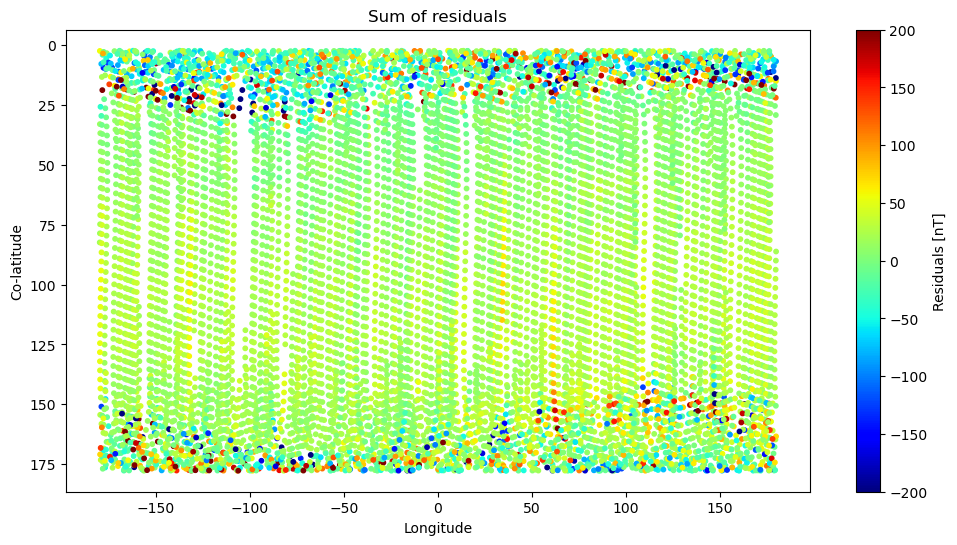

In [25]:
res = np.column_stack((residuals_r, residuals_t, residuals_p))
print(res.shape)


# Sum along the rows
res = np.sum(res, axis=1)



plt.figure(figsize=(12, 6))

sc = plt.scatter(data['lon'], data['colat'], s=10, c=res, cmap='jet')
plt.ylabel('Co-latitude')
plt.xlabel('Longitude')
plt.gca().invert_yaxis()
plt.title('Sum of residuals')

# Add colorbar
cbar = plt.colorbar(sc, label='Residuals [nT]', orientation='vertical')

# Set the range for the colorbar
min_value = -200  # Replace with the minimum value you want
max_value = 200  # Replace with the maximum value you want
sc.set_clim(vmin=min_value, vmax=max_value)

plt.show()

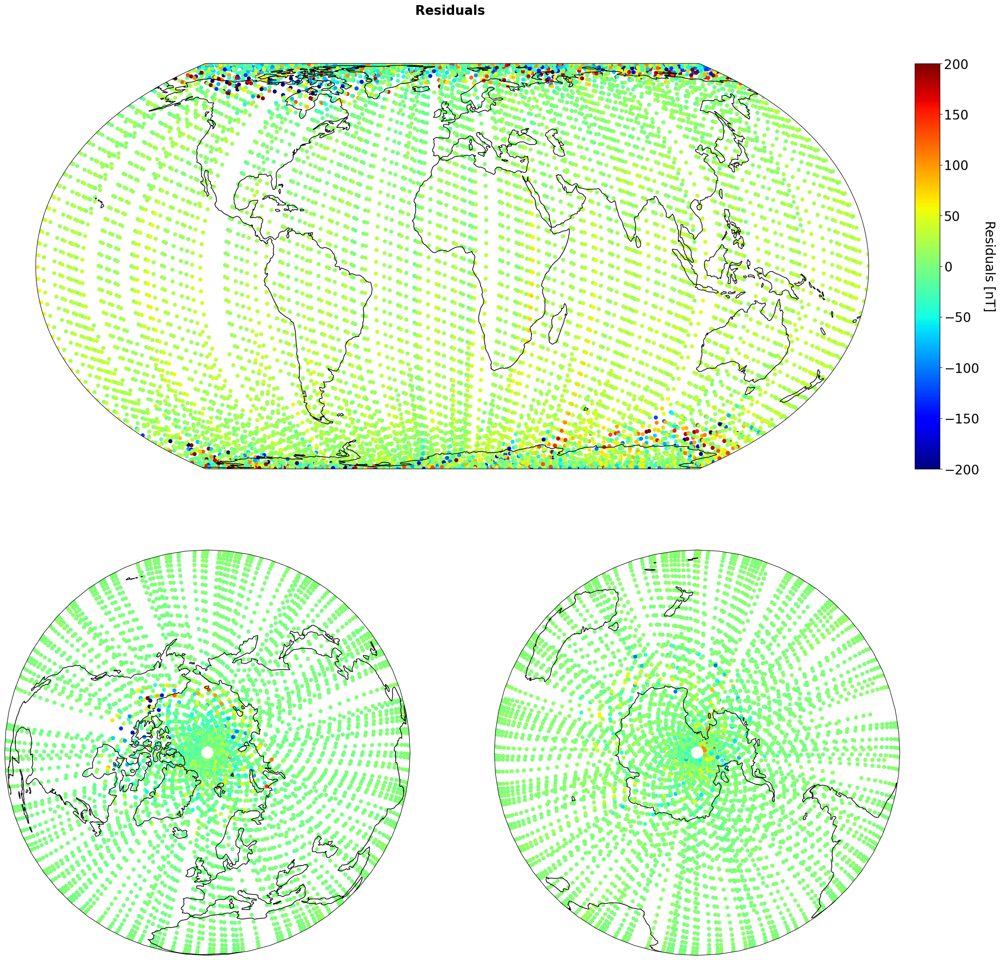

In [26]:
fig = plt.figure(figsize=(25, 25))
gs = fig.add_gridspec(2, 2)

axes = []
axes.append(plt.subplot(gs[1, 0], projection=ccrs.Orthographic(0, 90)))
axes.append(plt.subplot(gs[1, 1], projection=ccrs.Orthographic(180, -90)))
axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

for ax in axes:
    pc = ax.scatter(data['lon'], y=90 - data['colat'], s=40, c=res, edgecolors='none', cmap='jet',
                    transform=ccrs.PlateCarree())
    ax.coastlines(linewidth=1.1)

# Add colorbar
plt.title('Residuals \n \n \n', weight='bold', fontsize=20)

# inset axes into global map and move upwards
cax = inset_axes(axes[-1], width="3%", height="100%", loc='right', borderpad=-11)

# use last artist for the colorbar
clb = plt.colorbar(pc, cax=cax)
clb.ax.tick_params(labelsize=20)
clb.set_label('Residuals [nT]', rotation=270, labelpad=25, fontsize=20)

# Setting minimum and maximum values for colorbar
pc.set_clim(vmin=-200, vmax=200)  # Example values, you can set your own range


# (v) Downward continue field model

In [27]:
theta_grid = np.arange(0.5, 180.5, 1)
theta_grid = np.tile(theta_grid, 40320 // len(theta_grid) + 1)[:40320]
phi_grid = np.linspace(-179.4, 180.5, 180)
phi_grid = np.repeat(phi_grid, 224)

# making new design matrix with constant radius

G_radius_c, G_theta_c, G_phi_c = chaosmagpy.model_utils.design_gauss(6378, theta_grid, phi_grid, 
                                    nmax=13) #, *, nmin=None, mmax=None, source=None)


# magnetic components computed from the model
Br_pred_c = G_radius_c @ m #[0]               
Bt_pred_c = G_theta_c @ m #[0]
Bp_pred_c = G_phi_c @ m # [0]



X = -Bt_pred_c
Y = Bp_pred_c
Z = -Br_pred_c
H = np.sqrt(X**2 + Y**2)

F = np.sqrt(X**2 + Y**2 + Z**2)  # Field Intensity

inclination = np.arctan(Z/H)*180/np.pi    # Convert to degrees
declination = np.arctan(Y/X)*180/np.pi    # Convert to degrees




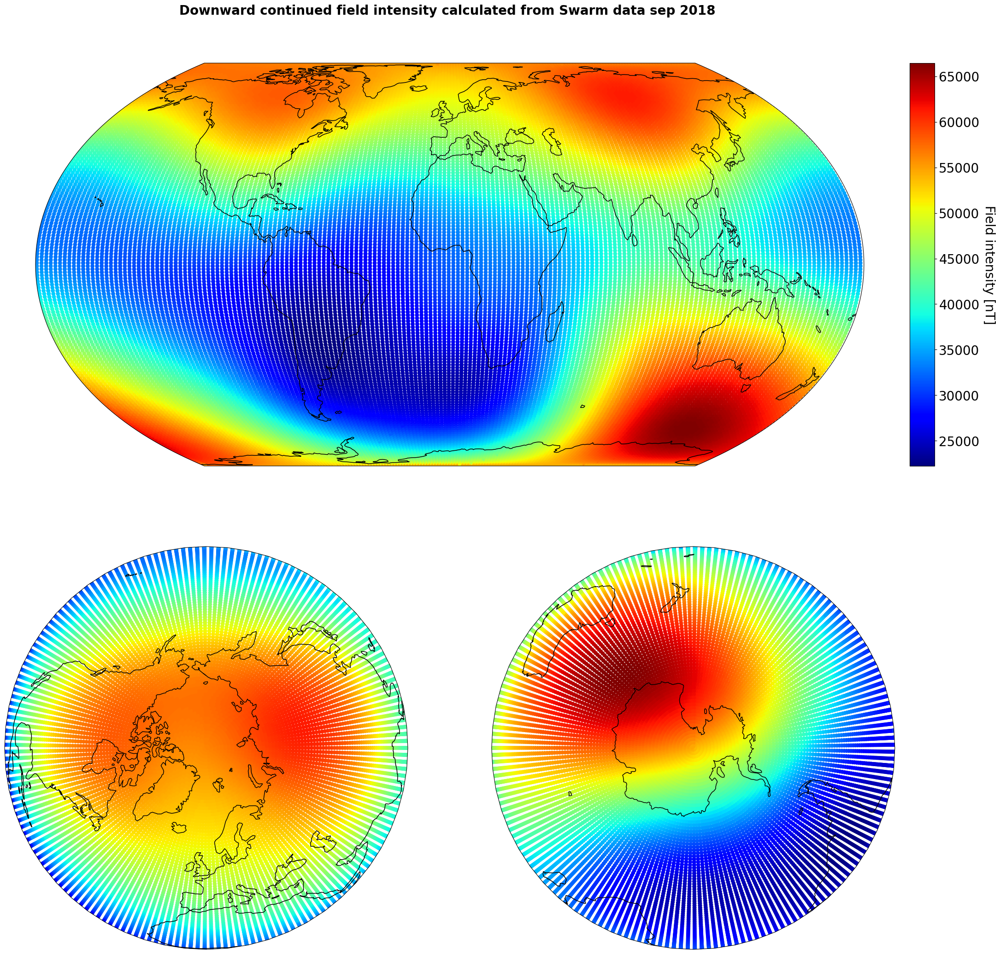

In [28]:
figure = plt.figure(figsize=(25, 25)) # Plot is from Chris' solution
gs = fig.add_gridspec(2, 2)

axes = []
axes.append(plt.subplot(gs[1, 0], projection=ccrs.Orthographic(0,90)))
axes.append(plt.subplot(gs[1, 1], projection=ccrs.Orthographic(180,-90)))
axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

for ax in axes:
        pc = ax.scatter(phi_grid, y=90-theta_grid, s = 40, c = F, edgecolors='none', cmap='jet', transform = ccrs.PlateCarree());
        ax.coastlines(linewidth=1.1);

# Add colorbar
    #inset axes into global map and move upwards
plt.title('Downward continued field intensity calculated from Swarm data sep 2018 \n \n \n', weight='bold', fontsize=20);
cax = inset_axes(axes[-1], width="3%", height="100%", loc='right',
                     borderpad=-11)

    # use last artist for the colorbar
clb = plt.colorbar(pc, cax=cax)
clb.ax.tick_params(labelsize=20)
clb.set_label('Field intensity [nT]', rotation=270, labelpad=25, fontsize=20)

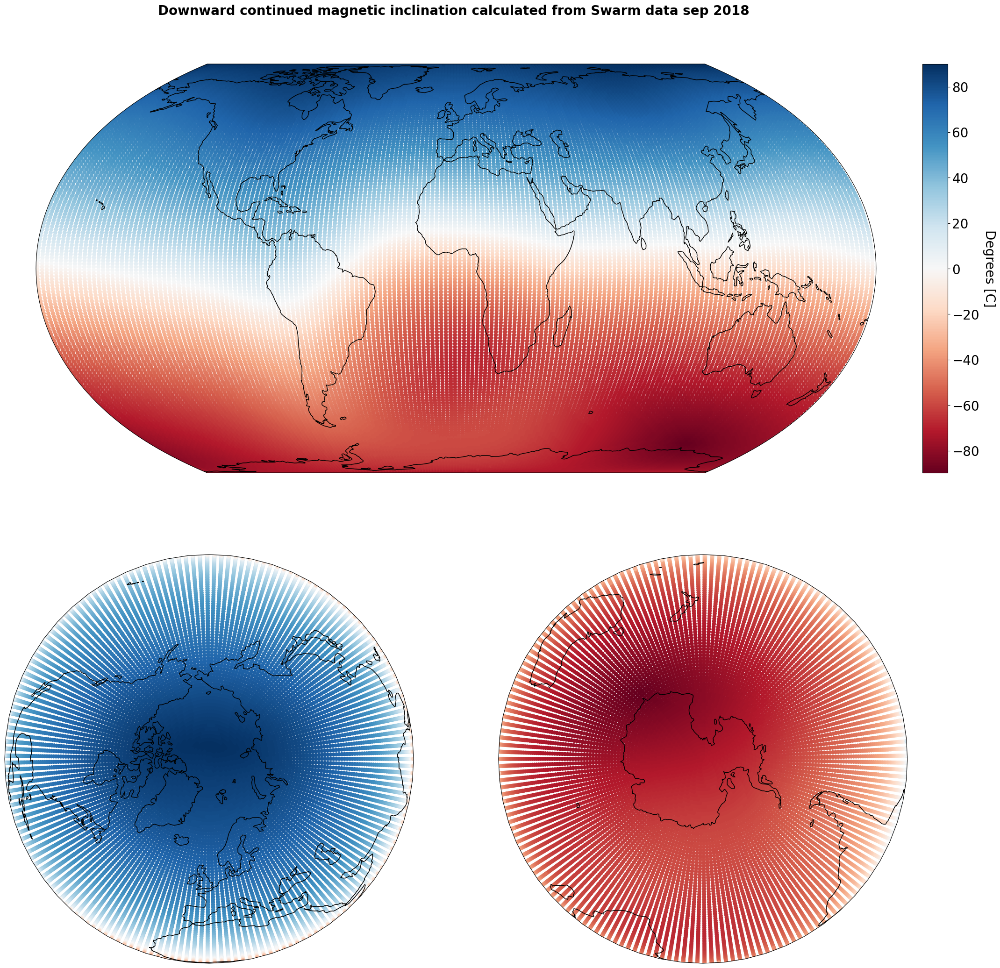

In [29]:
figure = plt.figure(figsize=(25, 25)) # Plot is from Chris' solution
gs = fig.add_gridspec(2, 2)

axes = []
axes.append(plt.subplot(gs[1, 0], projection=ccrs.Orthographic(0,90)))
axes.append(plt.subplot(gs[1, 1], projection=ccrs.Orthographic(180,-90)))
axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

for ax in axes:
        pc = ax.scatter(phi_grid, y=90-theta_grid, s = 40, c = inclination, edgecolors='none', cmap='RdBu', transform = ccrs.PlateCarree());
        ax.coastlines(linewidth=1.1);

# Add colorbar
    #inset axes into global map and move upwards
plt.title('Downward continued magnetic inclination calculated from Swarm data sep 2018 \n \n \n', weight='bold', fontsize=20);
cax = inset_axes(axes[-1], width="3%", height="100%", loc='right',
                     borderpad=-11)

    # use last artist for the colorbar
clb = plt.colorbar(pc, cax=cax)
clb.ax.tick_params(labelsize=20)
clb.set_label('Degrees [C]', rotation=270, labelpad=25, fontsize=20)

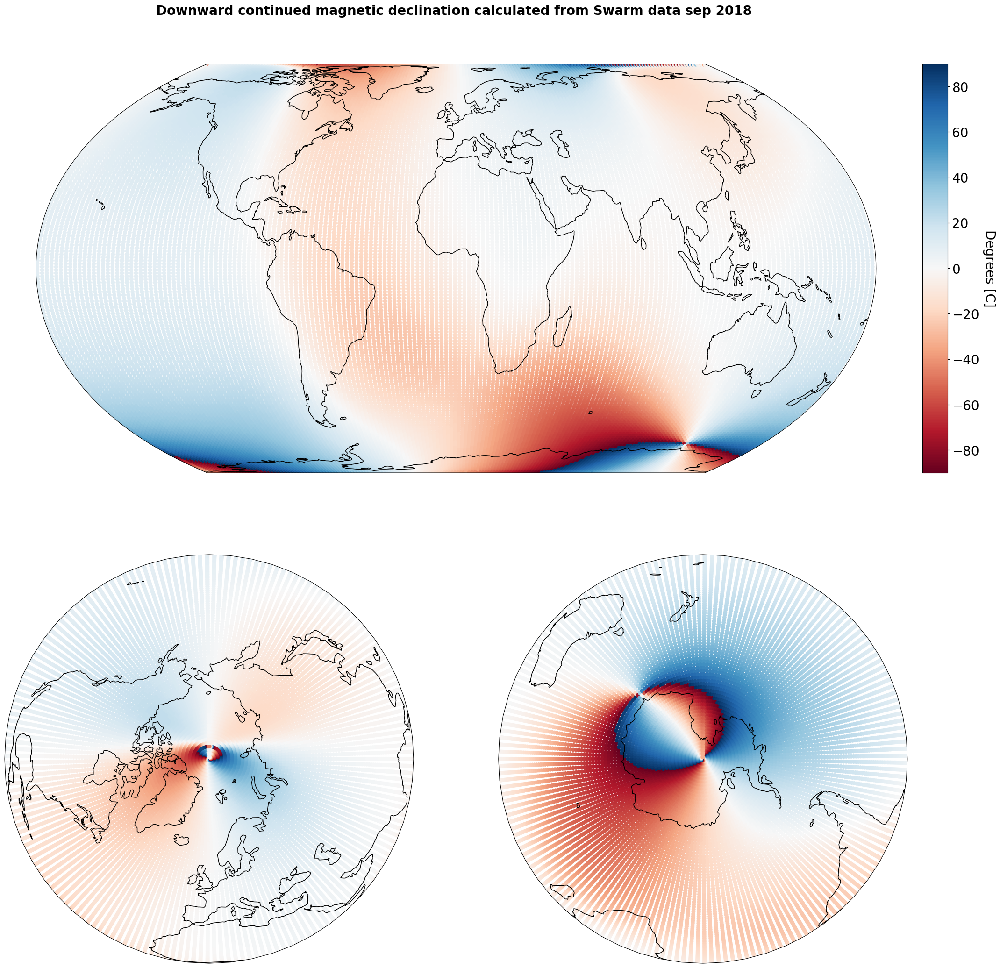

In [30]:
figure = plt.figure(figsize=(25, 25)) # Plot is from Chris' solution
gs = fig.add_gridspec(2, 2)

axes = []
axes.append(plt.subplot(gs[1, 0], projection=ccrs.Orthographic(0,90)))
axes.append(plt.subplot(gs[1, 1], projection=ccrs.Orthographic(180,-90)))
axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

for ax in axes:
        pc = ax.scatter(phi_grid, y=90-theta_grid, s = 40, c = declination, edgecolors='none', cmap='RdBu', transform = ccrs.PlateCarree());
        ax.coastlines(linewidth=1.1);

# Add colorbar
    #inset axes into global map and move upwards
plt.title('Downward continued magnetic declination calculated from Swarm data sep 2018 \n \n \n', weight='bold', fontsize=20);
cax = inset_axes(axes[-1], width="3%", height="100%", loc='right',
                     borderpad=-11)

    # use last artist for the colorbar
clb = plt.colorbar(pc, cax=cax)
clb.ax.tick_params(labelsize=20)
clb.set_label('Degrees [C]', rotation=270, labelpad=25, fontsize=20)

# Plot Br in CMB (c = 3485)

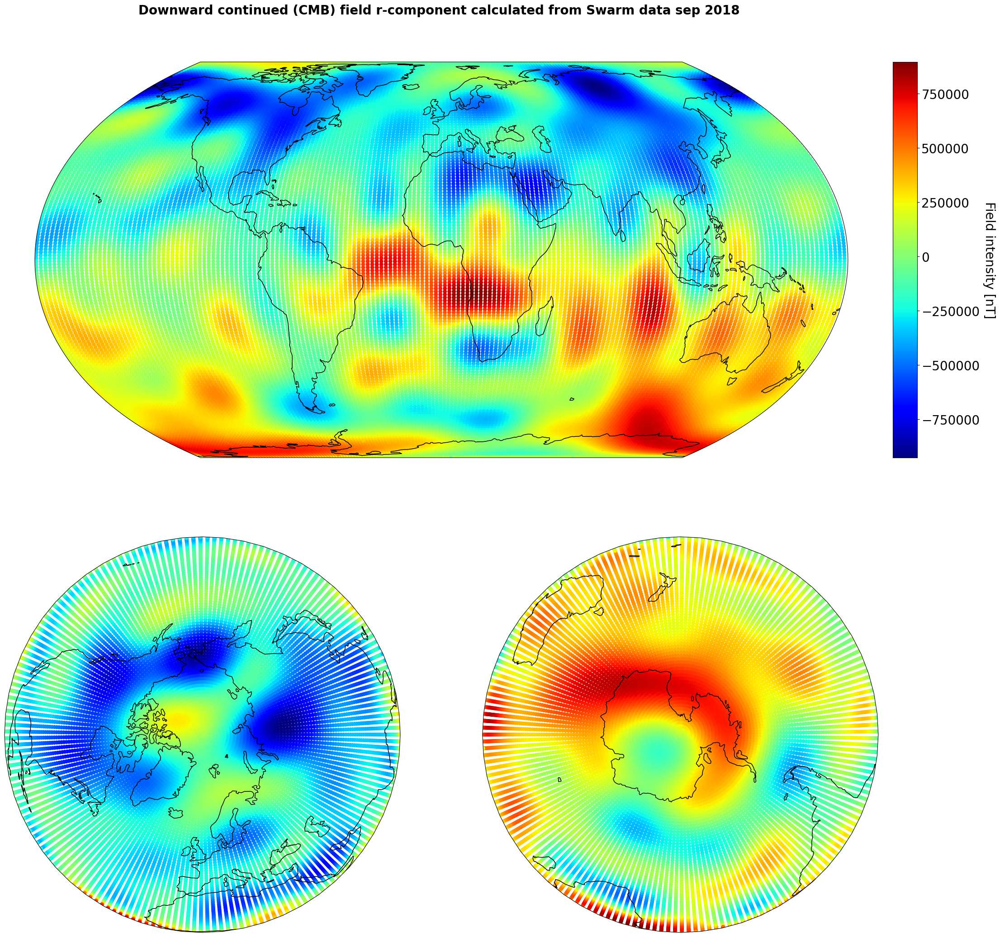

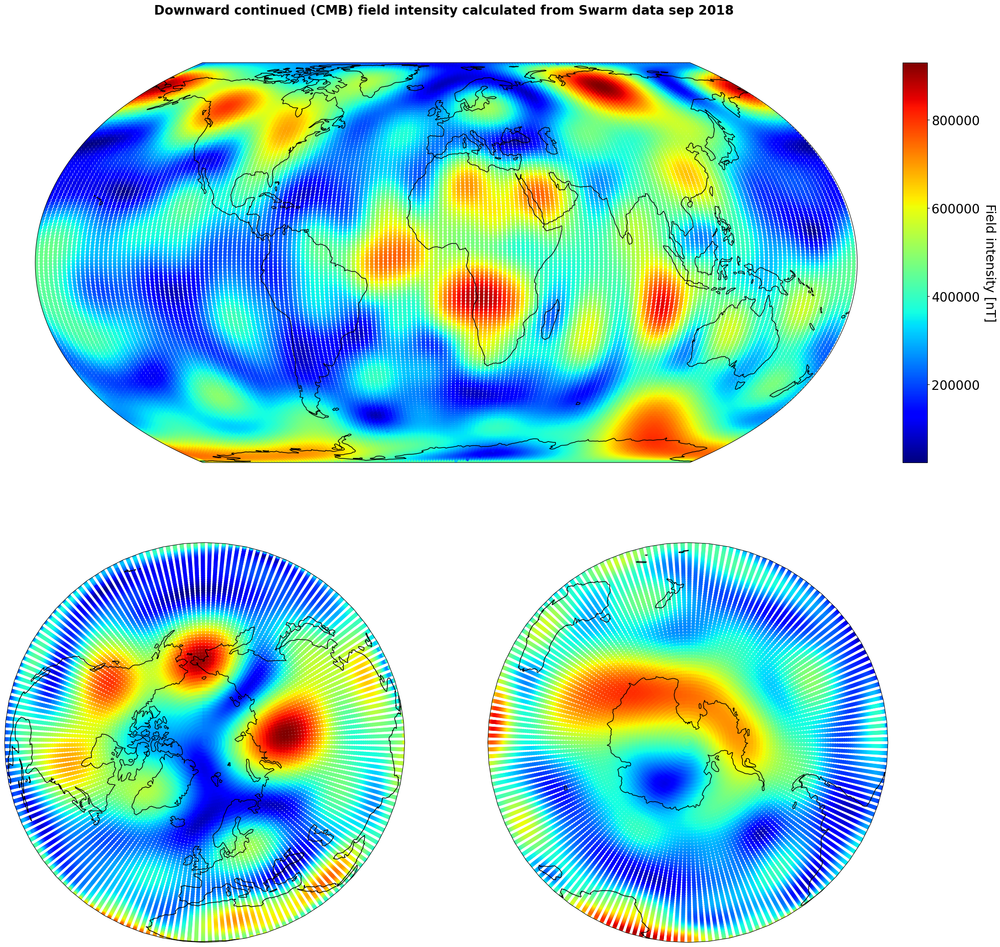

In [31]:
A_CMB_radius, A_CMB_theta, A_CMB_phi = chaosmagpy.model_utils.design_gauss(3485, theta_grid, phi_grid, nmax=13)

d_CMB_r = A_CMB_radius @ m
d_CMB_theta = A_CMB_theta @ m
d_CMB_phi = A_CMB_phi @ m

F_CMB = np.sqrt(d_CMB_r**2 + d_CMB_theta**2 + d_CMB_phi**2)


# Br in CMB
figure = plt.figure(figsize=(25, 25))
gs = fig.add_gridspec(2, 2)

axes = []
axes.append(plt.subplot(gs[1, 0], projection=ccrs.Orthographic(0,90)))
axes.append(plt.subplot(gs[1, 1], projection=ccrs.Orthographic(180,-90)))
axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

for ax in axes:
        pc = ax.scatter(phi_grid, y=90-theta_grid, s = 40, c = d_CMB_r, edgecolors='none', cmap='jet', transform = ccrs.PlateCarree());
        ax.coastlines(linewidth=1.1);

plt.title('Downward continued (CMB) field r-component calculated from Swarm data sep 2018 \n \n \n', weight='bold', fontsize=20);
cax = inset_axes(axes[-1], width="3%", height="100%", loc='right',
                     borderpad=-11)

clb = plt.colorbar(pc, cax=cax)
clb.ax.tick_params(labelsize=20)
clb.set_label('Field intensity [nT]', rotation=270, labelpad=25, fontsize=20)


# F in CMB
figure = plt.figure(figsize=(25, 25))
gs = fig.add_gridspec(2, 2)

axes = []
axes.append(plt.subplot(gs[1, 0], projection=ccrs.Orthographic(0,90)))
axes.append(plt.subplot(gs[1, 1], projection=ccrs.Orthographic(180,-90)))
axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

for ax in axes:
        pc = ax.scatter(phi_grid, y=90-theta_grid, s = 40, c = F_CMB, edgecolors='none', cmap='jet', transform = ccrs.PlateCarree());
        ax.coastlines(linewidth=1.1);

plt.title('Downward continued (CMB) field intensity calculated from Swarm data sep 2018 \n \n \n', weight='bold', fontsize=20);
cax = inset_axes(axes[-1], width="3%", height="100%", loc='right',
                     borderpad=-11)

clb = plt.colorbar(pc, cax=cax)
clb.ax.tick_params(labelsize=20)
clb.set_label('Field intensity [nT]', rotation=270, labelpad=25, fontsize=20)

# Apply external field

In [32]:
G_radius_ext, G_theta_ext, G_phi_ext = chaosmagpy.model_utils.design_gauss(data['radius'].values, data['colat'].values,data['lon'].values, 
                                    nmax=1, nmin=None, mmax=None, source='external')


print(G_radius_ext.shape)
print(G_theta_ext.shape)
print(G_phi_ext.shape)

G_ext = np.vstack((G_radius_ext, G_theta_ext, G_phi_ext))
print(G_ext.shape)
print(G.shape)

(10114, 3)
(10114, 3)
(10114, 3)
(30342, 3)
(30342, 195)


Solve for m only for external field

In [33]:
m_ext = np.linalg.solve(G_ext.T@G_ext, G_ext.T@d)    # same d

Residuals

c:\Users\alber\anaconda3\envs\EPM\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\alber\anaconda3\envs\EPM\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\alber\anaconda3\envs\EPM\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


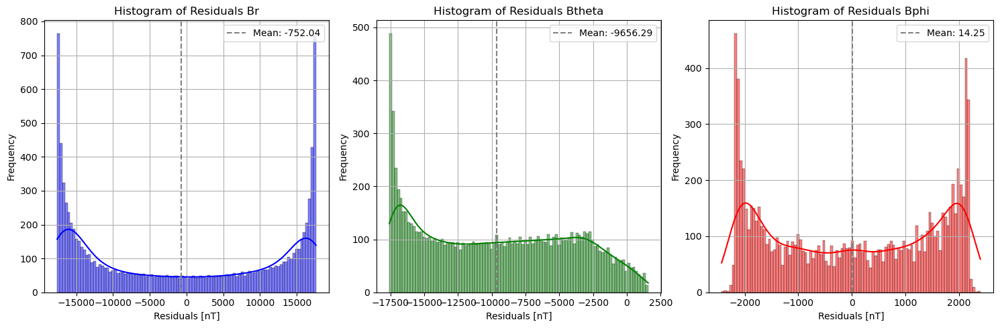

RMS error for Br component: 13494.241895972324
RMS error for Btheta component: 11144.65313649234
RMS error for Bphi component: 1542.0640157870464


In [34]:
# Calculating the residuals

# magnetic components computed from the model
Br_pred_ext = G_radius_ext @ m_ext
Bt_pred_ext = G_theta_ext @ m_ext 
Bp_pred_ext = G_phi_ext @ m_ext 



#d_pred = np.column_stack((Br_pred, Bt_pred, Bp_pred))


residuals_r = data['Br'] - (Br_pred_ext + Br_pred)
residuals_t = data['Btheta'] - (Bt_pred_ext + Bt_pred)
residuals_p = data['Bphi'] - (Bp_pred_ext + Bp_pred)


# Calculate mean of residuals for each component
mean_residuals_r = np.mean(residuals_r)
mean_residuals_t = np.mean(residuals_t)
mean_residuals_p = np.mean(residuals_p)

# Plot histogram of residuals
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Plot histogram of residuals_r with density curve
sns.histplot(residuals_r, bins=100, color='blue', kde=True, ax=axs[0])
axs[0].axvline(x=mean_residuals_r, color='grey', linestyle='--', label=f'Mean: {mean_residuals_r:.2f}')
axs[0].set_xlabel('Residuals [nT]')
axs[0].set_ylabel('Frequency')
axs[0].set_title('Histogram of Residuals Br')
axs[0].legend()
axs[0].grid(True)

# Plot histogram of residuals_t with density curve
sns.histplot(residuals_t, bins=100, color='green', kde=True, ax=axs[1])
axs[1].axvline(x=mean_residuals_t, color='grey', linestyle='--', label=f'Mean: {mean_residuals_t:.2f}')
axs[1].set_xlabel('Residuals [nT]')
axs[1].set_ylabel('Frequency')
axs[1].set_title('Histogram of Residuals Btheta')
axs[1].legend()
axs[1].grid(True)

# Plot histogram of residuals_p with density curve
sns.histplot(residuals_p, bins=100, color='red', kde=True, ax=axs[2])
axs[2].axvline(x=mean_residuals_p, color='grey', linestyle='--', label=f'Mean: {mean_residuals_p:.2f}')
axs[2].set_xlabel('Residuals [nT]')
axs[2].set_ylabel('Frequency')
axs[2].set_title('Histogram of Residuals Bphi')
axs[2].legend()
axs[2].grid(True)

# Adjust layout
plt.tight_layout()

plt.show()


# Calculate RMS error for each component
RMS_Br = np.sqrt(np.mean(residuals_r ** 2))
RMS_Btheta = np.sqrt(np.mean(residuals_t ** 2))
RMS_Bphi = np.sqrt(np.mean(residuals_p ** 2))

print("RMS error for Br component:", RMS_Br)
print("RMS error for Btheta component:", RMS_Btheta)
print("RMS error for Bphi component:", RMS_Bphi)

Combine the the two G matrices for internal and external field

In [35]:
# 1 = matrices are concatenated along the columns.
# 0 = matrices are concatenated along the rows
#G_tot = np.concatenate((G, G_ext), axis=0)


G_tot = np.hstack((G, G_ext))
print(G_tot.shape)


#len_grid = int(len(G_tot)/3)
#print(len_grid)


#theta_grid = np.linspace(0.5, 179.5, len_grid)
#phi_grid = np.linspace(-179.4, 180.5, len_grid)
#r_grid = np.linspace(0, max(data['radius']), len_grid)


#d = np.hstack((r_grid, theta_grid, phi_grid))
#print(d.shape)


m_tot = np.linalg.solve(G_tot.T@G_tot, G_tot.T@d)
print(m_tot.shape)


G_radius_tot, G_theta_tot, G_phi_tot = np.split(G_tot, 3, axis=0)
print(G_radius_tot.shape)

(30342, 198)
(198,)
(10114, 198)


# Predictions of external field

In [36]:
#G_r, G_t, G_p= chaosmagpy.model_utils.design_gauss(6378, theta_grid, phi_grid, 
                                    # nmax=1, nmin=None, mmax=None, source='external')
#print(G_r.shape)


# magnetic components computed from the model
Br_pred_c = G_radius_tot @ m_tot       
Bt_pred_c = G_theta_tot @ m_tot
Bp_pred_c = G_phi_tot @ m_tot



X = -Bt_pred_c
Y = Bp_pred_c
Z = -Br_pred_c
H = np.sqrt(X**2 + Y**2)

F = np.sqrt(X**2 + Y**2 + Z**2)  # Field Intensity

inclination = np.arctan(Z/H)*180/np.pi    # Convert to degrees
declination = np.arctan(Y/X)*180/np.pi    # Convert to degrees

F.shape

(10114,)

c:\Users\alber\anaconda3\envs\EPM\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\alber\anaconda3\envs\EPM\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\alber\anaconda3\envs\EPM\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


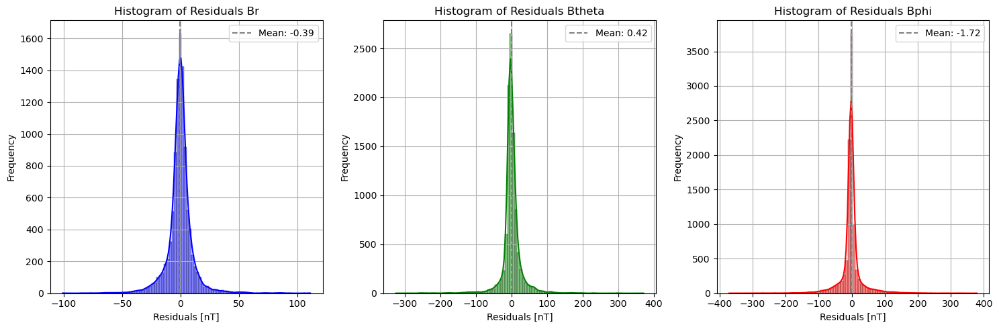

RMS error for Br component: 11.695880052852429
RMS error for Btheta component: 30.400579976486362
RMS error for Bphi component: 38.32496132157178


In [37]:
residuals_r = data['Br'] - Br_pred_c
residuals_t = data['Btheta'] - Bt_pred_c
residuals_p = data['Bphi'] - Bp_pred_c


# Calculate mean of residuals for each component
mean_residuals_r = np.mean(residuals_r)
mean_residuals_t = np.mean(residuals_t)
mean_residuals_p = np.mean(residuals_p)

# Plot histogram of residuals
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Plot histogram of residuals_r with density curve
sns.histplot(residuals_r, bins=100, color='blue', kde=True, ax=axs[0])
axs[0].axvline(x=mean_residuals_r, color='grey', linestyle='--', label=f'Mean: {mean_residuals_r:.2f}')
axs[0].set_xlabel('Residuals [nT]')
axs[0].set_ylabel('Frequency')
axs[0].set_title('Histogram of Residuals Br')
axs[0].legend()
axs[0].grid(True)

# Plot histogram of residuals_t with density curve
sns.histplot(residuals_t, bins=100, color='green', kde=True, ax=axs[1])
axs[1].axvline(x=mean_residuals_t, color='grey', linestyle='--', label=f'Mean: {mean_residuals_t:.2f}')
axs[1].set_xlabel('Residuals [nT]')
axs[1].set_ylabel('Frequency')
axs[1].set_title('Histogram of Residuals Btheta')
axs[1].legend()
axs[1].grid(True)

# Plot histogram of residuals_p with density curve
sns.histplot(residuals_p, bins=100, color='red', kde=True, ax=axs[2])
axs[2].axvline(x=mean_residuals_p, color='grey', linestyle='--', label=f'Mean: {mean_residuals_p:.2f}')
axs[2].set_xlabel('Residuals [nT]')
axs[2].set_ylabel('Frequency')
axs[2].set_title('Histogram of Residuals Bphi')
axs[2].legend()
axs[2].grid(True)

# Adjust layout
plt.tight_layout()

plt.show()


# Calculate RMS error for each component
RMS_Br = np.sqrt(np.mean(residuals_r ** 2))
RMS_Btheta = np.sqrt(np.mean(residuals_t ** 2))
RMS_Bphi = np.sqrt(np.mean(residuals_p ** 2))

print("RMS error for Br component:", RMS_Br)
print("RMS error for Btheta component:", RMS_Btheta)
print("RMS error for Bphi component:", RMS_Bphi)

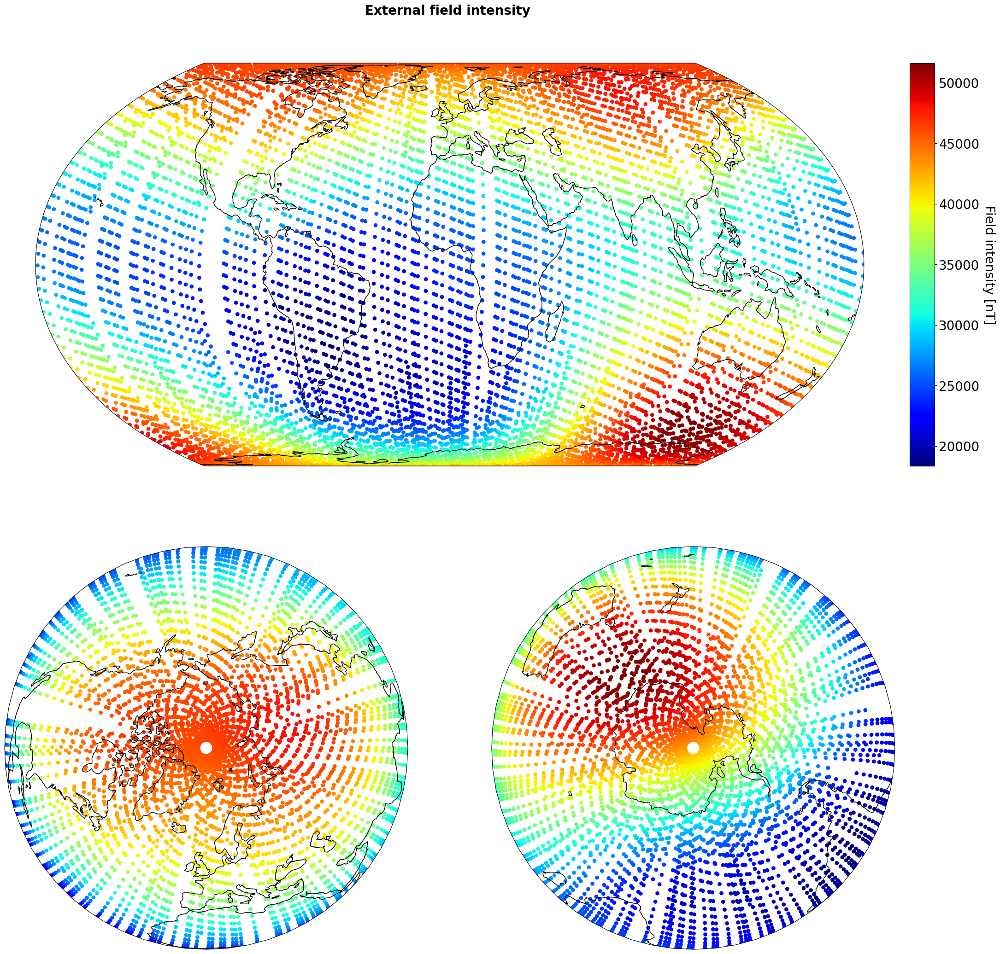

In [38]:
figure = plt.figure(figsize=(25, 25)) # Plot is from Chris' solution
gs = fig.add_gridspec(2, 2)

axes = []
axes.append(plt.subplot(gs[1, 0], projection=ccrs.Orthographic(0,90)))
axes.append(plt.subplot(gs[1, 1], projection=ccrs.Orthographic(180,-90)))
axes.append(plt.subplot(gs[0, :], projection=ccrs.EqualEarth()))

for ax in axes:
        pc = ax.scatter(data['lon'], y=90-data['colat'], s = 40, c = F, edgecolors='none', cmap='jet', transform = ccrs.PlateCarree());
        ax.coastlines(linewidth=1.1);

# Add colorbar
    #inset axes into global map and move upwards
plt.title('External field intensity \n \n \n', weight='bold', fontsize=20);
cax = inset_axes(axes[-1], width="3%", height="100%", loc='right',
                     borderpad=-11)

    # use last artist for the colorbar
clb = plt.colorbar(pc, cax=cax)
clb.ax.tick_params(labelsize=20)
clb.set_label('Field intensity [nT]', rotation=270, labelpad=25, fontsize=20)

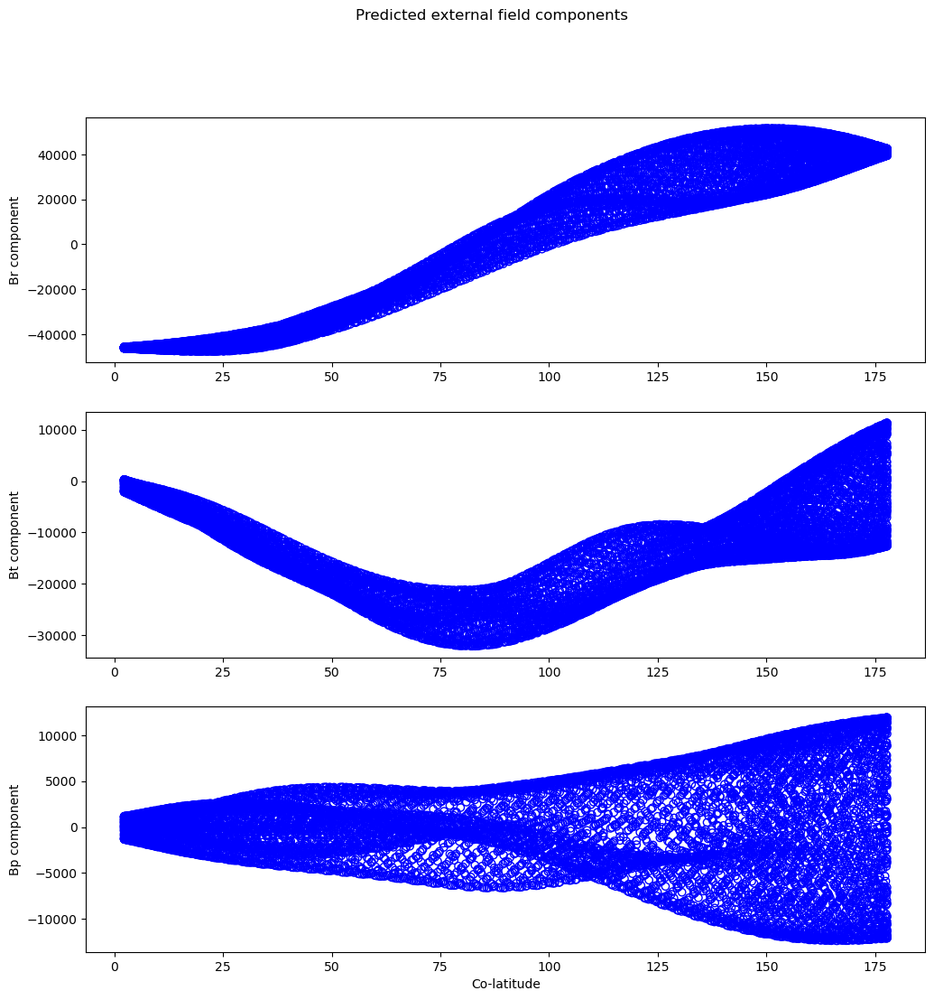

In [39]:
fig, axs = plt.subplots(3, 1, figsize=(12, 12))

axs[0].scatter(data['colat'], Br_pred_c, label='X component', facecolors='none', edgecolors='blue')
axs[1].scatter(data['colat'], Bt_pred_c, label='Y component', facecolors='none', edgecolors='blue')
axs[2].scatter(data['colat'], Bp_pred_c, label='Z component', facecolors='none', edgecolors='blue')

axs[0].set_ylabel('Br component')
axs[1].set_ylabel('Bt component')
axs[2].set_ylabel('Bp component')
axs[2].set_xlabel('Co-latitude')
fig.suptitle('Predicted external field components')
plt.show()

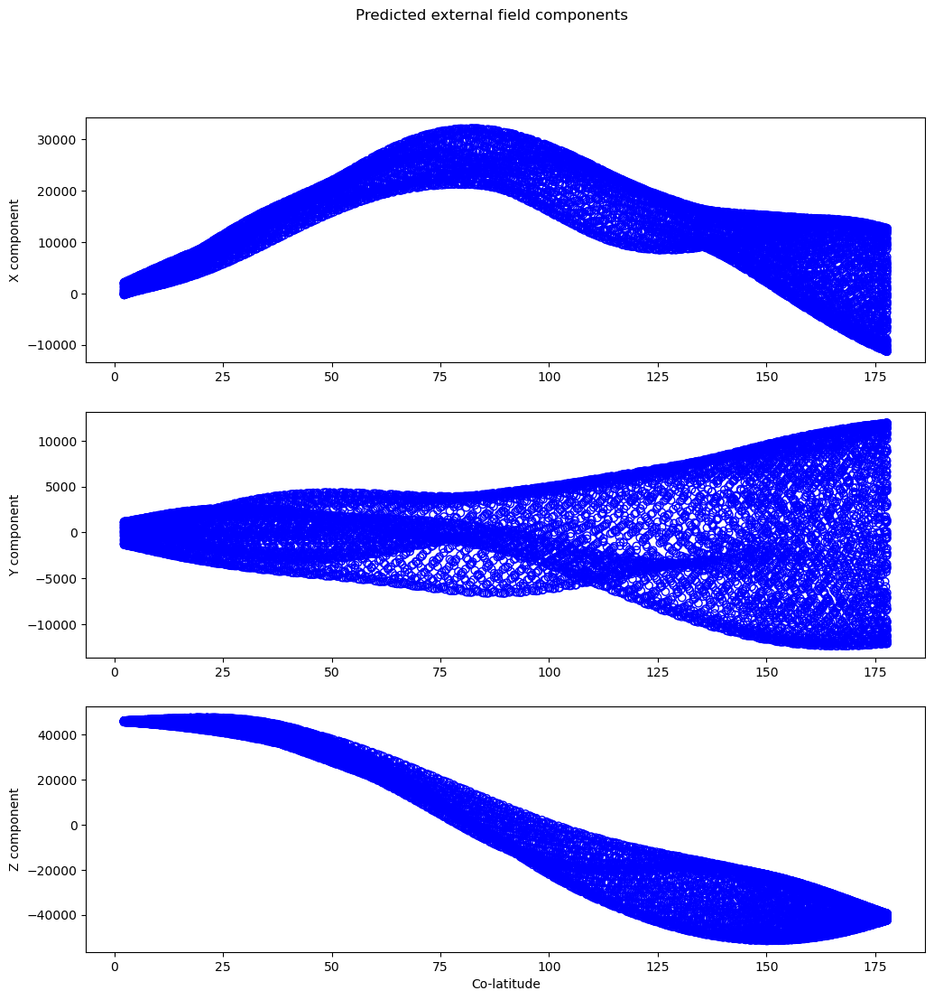

In [40]:
fig, axs = plt.subplots(3, 1, figsize=(12, 12))

axs[0].scatter(data['colat'], X, label='X component', facecolors='none', edgecolors='blue')
axs[1].scatter(data['colat'], Y, label='Y component', facecolors='none', edgecolors='blue')
axs[2].scatter(data['colat'], Z, label='Z component', facecolors='none', edgecolors='blue')

axs[0].set_ylabel('X component')
axs[1].set_ylabel('Y component')
axs[2].set_ylabel('Z component')
axs[2].set_xlabel('Co-latitude')
fig.suptitle('Predicted external field components')
plt.show()

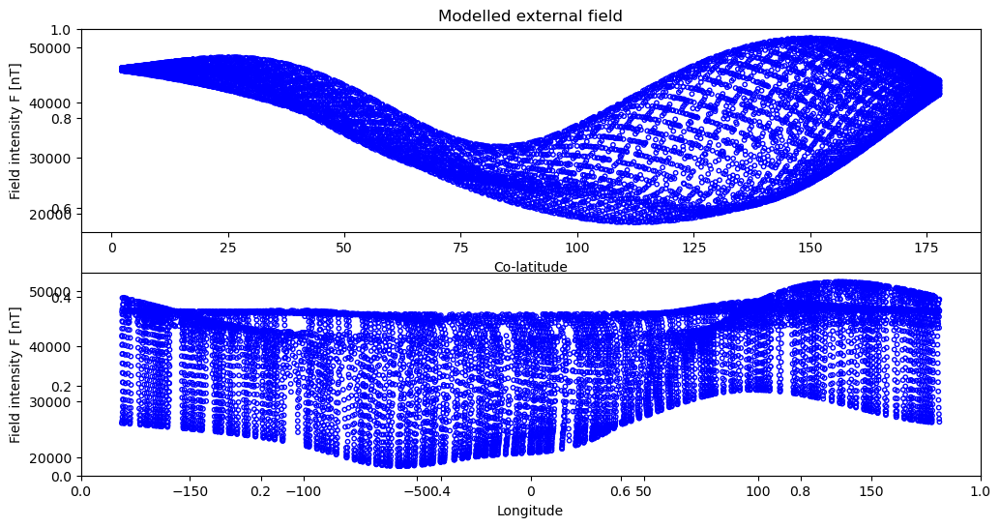

In [41]:
plt.figure(figsize=(12, 6))
plt.title('Modelled external field')

plt.subplot(2, 1, 1)
plt.scatter(data['colat'], F, s = 10, facecolors='none', edgecolors='blue')
plt.ylabel('Field intensity F [nT]')
plt.xlabel('Co-latitude')

plt.subplot(2, 1, 2)
plt.scatter(data['lon'], F, s = 10, facecolors='none', edgecolors='blue')
plt.ylabel('Field intensity F [nT]')
plt.xlabel('Longitude')

plt.show()